In [ ]:
import numpy as np
import mne
import json
import os

# Load manifest
manifest_path = '/System/Volumes/Data/misc/data12/sjapee/Sebastian-OrientationImagery/!Important Data/test/error_manifest.json'
with open(manifest_path, 'r') as f:
    manifest = json.load(f)

# Dictionary to hold loaded data
subject_data = {}

for subject, paths in manifest.items():
    print(f"Loading {subject}...")

    # Load errors
    error_array = np.load(paths["error_file"])

    # Load epochs
    epochs = mne.read_epochs(paths["epochs_file"], preload=False)

    subject_data[subject] = {
        'epochs_mini': epochs,
        'errors': error_array
    }

# ✅ Optional: check structure
for subject in subject_data:
    print(f"{subject}: errors shape = {subject_data[subject]['errors'].shape}")


In [ ]:
import numpy as np
import mne
import os

# List of subjects
subjects = [f"S{i:02}" for i in range(9, 21)]

# Paths
error_root = '/Volumes/OrientationDecoding/bids_dir/derivatives/CrossDecode'
data_path = '/System/Volumes/Data/misc/data12/sjapee/Sebastian-OrientationImagery/Data/Bids/derivatives/preprocessed/'

# Dictionary to store results
subject_data = {}

for subject in subjects:
    print(f"Processing {subject}...")

    # Load epochs
    epoch_path = os.path.join(data_path, f'sub-{subject}_miniEpochs_preprocessed-epo.fif')
    epochs_mini = mne.read_epochs(epoch_path, preload=False)

    # Path to subject's error files
    subject_dir = os.path.join(error_root, subject)
    
    error_list = []
    num_train_times = 961

    for t in range(num_train_times):
        error_file = os.path.join(subject_dir, f"{subject}_errors_{t}.npy")
        if os.path.exists(error_file):
            error_data = np.load(error_file)
            error_list.append(error_data)
        else:
            print(f"Missing: {error_file}")
            # Fallback with NaNs
            error_list.append(np.full((len(epochs_mini), len(epochs_mini.times)), np.nan))

    # Stack shape: (train_time, trials, test_time)
    error_stack = np.stack(error_list, axis=0)

    # Transpose → (trials, test_time, train_time)
    error_stack = np.transpose(error_stack, (1, 2, 0))

    subject_data[subject] = {
        'epochs_mini': epochs_mini,
        'errors': error_stack
    }

# ✅ Check one subject
for subject in subjects:
    errors = subject_data[subject]['errors']
    print(f"{subject}: error shape = {errors.shape}")  # Expect (n_trials, n_test_times, n_train_times)
    print(errors[:2, :2, :5])  # Preview: 2 trials × 2 test times × 5 train times


In [1]:
import numpy as np
import mne
import os
import pickle

subjects = [f"S{i:02}" for i in range(1, 21)]

# Paths
error_root = '/Volumes/OrientationDecoding/bids_dir/derivatives/CrossDecode'
data_path = '/System/Volumes/Data/misc/data12/sjapee/Sebastian-OrientationImagery/Data/Bids/derivatives/preprocessed/'
output_path = '/System/Volumes/Data/misc/data12/sjapee/Sebastian-OrientationImagery/!Important Data/processed_analysis_data'
os.makedirs(output_path, exist_ok=True)

for subject in subjects:
    print(f"Processing {subject}...")

    # Load epochs metadata
    epoch_path = os.path.join(data_path, f'sub-{subject}_miniEpochs_preprocessed-epo.fif')
    epochs_mini = mne.read_epochs(epoch_path, preload=False)
    metadata = epochs_mini.metadata

    # Extract timepoint -> trial index mapping
    timepoint_indices = {}
    for tp in np.unique(metadata["timepoints"]):
        timepoint_indices[int(tp)] = metadata[metadata["timepoints"] == tp].index.to_numpy()

    # Load error stack
    error_list = []
    subject_dir = os.path.join(error_root, subject)
    num_train_times = 961
    n_trials = len(epochs_mini)
    n_times = len(epochs_mini.times)

    for t in range(num_train_times):
        error_file = os.path.join(subject_dir, f"{subject}_errors_{t}.npy")
        if os.path.exists(error_file):
            error_data = np.load(error_file)
        else:
            print(f"Missing: {error_file}")
            error_data = np.full((n_trials, n_times), np.nan)
        error_list.append(error_data)

    error_stack = np.transpose(np.stack(error_list, axis=0), (1, 2, 0))  # (trials, test_time, train_time)

    # Save a dictionary with errors and trial indices
    save_dict = {
        "errors": error_stack,
        "trial_indices_by_tp": timepoint_indices
    }

    # Use pickle for easier loading
    with open(os.path.join(output_path, f"{subject}_errors_and_indices.pkl"), "wb") as f:
        pickle.dump(save_dict, f)

    print(f"Saved {subject}")


Processing S01...
Reading /System/Volumes/Data/misc/data12/sjapee/Sebastian-OrientationImagery/Data/Bids/derivatives/preprocessed/sub-S01_miniEpochs_preprocessed-epo.fif ...
    Found the data of interest:
        t =       0.00 ...      49.17 ms
        0 CTF compensation matrices available
Adding metadata with 6 columns
26880 matching events found
No baseline correction applied
0 projection items activated
Saved S01
Processing S02...
Reading /System/Volumes/Data/misc/data12/sjapee/Sebastian-OrientationImagery/Data/Bids/derivatives/preprocessed/sub-S02_miniEpochs_preprocessed-epo.fif ...
    Found the data of interest:
        t =       0.00 ...      49.17 ms
        0 CTF compensation matrices available
Adding metadata with 6 columns
26880 matching events found
No baseline correction applied
0 projection items activated


KeyboardInterrupt: 

In [ ]:
import numpy as np
import pickle
import os
import matplotlib.pyplot as plt

input_path = '/System/Volumes/Data/misc/data12/sjapee/Sebastian-OrientationImagery/!Important Data/processed_analysis_data'
subjects = [f"S{i:02}" for i in range(1, 21)]

# Load one subject to get shape info
with open(os.path.join(input_path, f"{subjects[0]}_errors_and_indices.pkl"), "rb") as f:
    example = pickle.load(f)
    n_test_times = example["errors"].shape[1]
    n_train_times = example["errors"].shape[2]

# Initialize output
median_errors_matrix = np.zeros((n_test_times, n_train_times))
mad_errors_matrix = np.zeros((n_test_times, n_train_times))

for tp in range(n_test_times):
    pooled_errors_by_train = [[] for _ in range(n_train_times)]

    for subject in subjects:
        file_path = os.path.join(input_path, f"{subject}_errors_and_indices.pkl")
        with open(file_path, "rb") as f:
            data = pickle.load(f)
            errors = data["errors"]
            trial_idx = data["trial_indices_by_tp"].get(tp, [])

            if len(trial_idx) == 0:
                continue

            for train_time in range(n_train_times):
                values = errors[trial_idx, tp, train_time].flatten()
                pooled_errors_by_train[train_time].append(values)

    # Compute across all subjects for this test time
    for train_time in range(n_train_times):
        pooled = np.concatenate(pooled_errors_by_train[train_time]) if pooled_errors_by_train[train_time] else np.array([np.nan])
        median_errors_matrix[tp, train_time] = np.median(pooled)
        mad_errors_matrix[tp, train_time] = np.median(np.abs(pooled - np.median(pooled)))

# Plot
plt.figure(figsize=(10, 6))
vmax = np.max(np.abs(median_errors_matrix))
vmin = -vmax

plt.subplot(1, 2, 1)
plt.imshow(median_errors_matrix.T, origin="lower", aspect="auto", cmap="seismic", vmin=vmin, vmax=vmax)
plt.colorbar(label="Median Signed Error (deg)")
plt.xlabel("Testing Time")
plt.ylabel("Training Time")
plt.title("Median Signed Error")

plt.subplot(1, 2, 2)
plt.imshow(mad_errors_matrix.T, origin="lower", aspect="auto", cmap="magma")
plt.colorbar(label="Median Absolute Deviation (deg)")
plt.xlabel("Testing Time")
plt.ylabel("Training Time")
plt.title("Error Spread (MAD)")

plt.tight_layout()
plt.show()


In [2]:
import numpy as np
import mne
import os
import json

subjects = [f"S{i:02}" for i in range(1, 21)]

error_root = '/Volumes/OrientationDecoding/bids_dir/derivatives/CrossDecode'
data_path = '/System/Volumes/Data/misc/data12/sjapee/Sebastian-OrientationImagery/Data/Bids/derivatives/preprocessed/'

output_path = '/System/Volumes/Data/misc/data12/sjapee/Sebastian-OrientationImagery/!Important Data/errors_np'
os.makedirs(output_path, exist_ok=True)

for subject in subjects:
    print(f"Processing {subject}...")

    # Load epochs (metadata only)
    epoch_path = os.path.join(data_path, f'sub-{subject}_miniEpochs_preprocessed-epo.fif')
    epochs_mini = mne.read_epochs(epoch_path, preload=False)

    n_trials = len(epochs_mini)
    n_times = len(epochs_mini.times)

    # Create trial indices by timepoint dict
    # Convert to int keys for JSON compatibility
    timepoint_indices = {
        int(tp): epochs_mini.metadata[epochs_mini.metadata.timepoints == tp].index.to_list()
        for tp in epochs_mini.metadata.timepoints.unique()
    }

    # Load and stack errors
    error_list = []
    num_train_times = 961
    subject_dir = os.path.join(error_root, subject)

    for t in range(num_train_times):
        error_file = os.path.join(subject_dir, f"{subject}_errors_{t}.npy")
        if os.path.exists(error_file):
            error_data = np.load(error_file)
        else:
            print(f"Missing: {error_file}")
            error_data = np.full((n_trials, n_times), np.nan)
        error_list.append(error_data)

    # Stack → transpose (trials, test_time, train_time)
    error_stack = np.transpose(np.stack(error_list, axis=0), (1, 2, 0))

    # Save errors array as .npy (large, mmap-able)
    np.save(os.path.join(output_path, f"{subject}_errors.npy"), error_stack)

    # Save indices dict as JSON (small, fast)
    with open(os.path.join(output_path, f"{subject}_trial_indices.json"), 'w') as f:
        json.dump(timepoint_indices, f)

    print(f"Saved {subject} errors.npy and trial_indices.json")


Processing S01...
Reading /System/Volumes/Data/misc/data12/sjapee/Sebastian-OrientationImagery/Data/Bids/derivatives/preprocessed/sub-S01_miniEpochs_preprocessed-epo.fif ...
    Found the data of interest:
        t =       0.00 ...      49.17 ms
        0 CTF compensation matrices available
Adding metadata with 6 columns
26880 matching events found
No baseline correction applied
0 projection items activated
Saved S01 errors.npy and trial_indices.json
Processing S02...
Reading /System/Volumes/Data/misc/data12/sjapee/Sebastian-OrientationImagery/Data/Bids/derivatives/preprocessed/sub-S02_miniEpochs_preprocessed-epo.fif ...
    Found the data of interest:
        t =       0.00 ...      49.17 ms
        0 CTF compensation matrices available
Adding metadata with 6 columns
26880 matching events found
No baseline correction applied
0 projection items activated
Saved S02 errors.npy and trial_indices.json
Processing S03...
Reading /System/Volumes/Data/misc/data12/sjapee/Sebastian-OrientationI

KeyboardInterrupt: 

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import json
import os

data_dir = '/System/Volumes/Data/misc/data12/sjapee/Sebastian-OrientationImagery/!Important Data/errors_np'
subjects = [f"S{i:02}" for i in range(9, 21)]  # adjust to your subjects list

# Load example subject to get shape info
example_errors = np.load(os.path.join(data_dir, f"{subjects[0]}_errors.npy"), mmap_mode='r')
n_trials, n_test_times, n_train_times = example_errors.shape

# Preallocate output matrix
median_errors_matrix = np.zeros((n_test_times, n_train_times))

# Loop over test timepoints
for tp in range(n_test_times):
    pooled_errors_by_train = [[] for _ in range(n_train_times)]

    # For each subject, load their trial indices and error data on demand
    for subj in subjects:
        # Load trial indices (dict: test_timepoint -> list of trial indices)
        with open(os.path.join(data_dir, f"{subj}_trial_indices.json"), 'r') as f:
            trial_indices = json.load(f)

        # Get trial indices for current test timepoint as a list of ints
        # JSON keys are strings, so convert tp to string first
        trials_for_tp = trial_indices.get(str(tp), [])
        if not trials_for_tp:
            # No trials for this test time point; skip this subject for this tp
            continue

        # Load errors with mmap (lazy loading)
        errors = np.load(os.path.join(data_dir, f"{subj}_errors.npy"), mmap_mode='r')

        # For each train time, collect errors for trials at this test time
        for train_time in range(n_train_times):
            # Index errors: trials x test_time x train_time
            values = errors[trials_for_tp, tp, train_time]
            pooled_errors_by_train[train_time].append(values)

    # Now pool all subject errors per train time and compute median
    for train_time in range(n_train_times):
        if pooled_errors_by_train[train_time]:
            all_vals = np.concatenate(pooled_errors_by_train[train_time])
            median_errors_matrix[tp, train_time] = np.nanmedian(all_vals)  # nanmedian in case of NaNs
        else:
            median_errors_matrix[tp, train_time] = np.nan  # or some sentinel value

# Plot
plt.figure(figsize=(10, 6))
vmax = np.nanmax(np.abs(median_errors_matrix))
vmin = -vmax

plt.imshow(median_errors_matrix.T, origin='lower', aspect='auto', cmap='seismic', vmin=vmin, vmax=vmax)
plt.colorbar(label='Median Signed Error (deg)')
plt.xlabel('Testing Time')
plt.ylabel('Training Time')
plt.title('Pooled Subject Temporal Generalization (Median Signed Errors)')
plt.tight_layout()
plt.show()


In [3]:
import numpy as np
import mne
import os
import matplotlib.pyplot as plt

subjects = [f"S{i:02}" for i in range(1, 21)]
error_root = '/Volumes/OrientationDecoding/bids_dir/derivatives/CrossDecode'
data_path = '/System/Volumes/Data/misc/data12/sjapee/Sebastian-OrientationImagery/Data/Bids/derivatives/preprocessed/'
summary_outdir = '/System/Volumes/Data/misc/data12/sjapee/Sebastian-OrientationImagery/!Important Data/test'
os.makedirs(summary_outdir, exist_ok=True)

for subject in subjects:
    print(f"Processing {subject}...")

    epoch_path = os.path.join(data_path, f'sub-{subject}_miniEpochs_preprocessed-epo.fif')
    epochs_mini = mne.read_epochs(epoch_path, preload=False)

    subject_dir = os.path.join(error_root, subject)
    num_train_times = 961

    error_list = []
    for t in range(num_train_times):
        error_file = os.path.join(subject_dir, f"{subject}_errors_{t}.npy")
        if os.path.exists(error_file):
            error_data = np.load(error_file)
        else:
            print(f"Missing: {error_file}")
            error_data = np.full((len(epochs_mini), len(epochs_mini.times)), np.nan)
        error_list.append(error_data)

    error_stack = np.stack(error_list, axis=0)
    error_stack = np.transpose(error_stack, (1, 2, 0))  # (trials, test_time, train_time)

    n_test_times = error_stack.shape[1]
    n_train_times = error_stack.shape[2]

    median_errors = np.zeros((n_test_times, n_train_times))
    mad_errors = np.zeros((n_test_times, n_train_times))

    for tp in range(n_test_times):
        # Get trial indices for this test timepoint
        trial_idx = epochs_mini.metadata[epochs_mini.metadata.timepoints == tp].index.to_numpy()
        for train_time in range(n_train_times):
            toplot = error_stack[trial_idx, tp, train_time].flatten()
            median_errors[tp, train_time] = np.nanmedian(toplot)
            mad_errors[tp, train_time] = np.nanmedian(np.abs(toplot - np.nanmedian(toplot)))

    # Save per-subject results to disk
    np.save(os.path.join(summary_outdir, f"{subject}_median_errors.npy"), median_errors)
    np.save(os.path.join(summary_outdir, f"{subject}_mad_errors.npy"), mad_errors)

    print(f"Saved summary for {subject}")

    # Clear big data before next subject
    del error_stack, epochs_mini, median_errors, mad_errors


Processing S01...
Reading /System/Volumes/Data/misc/data12/sjapee/Sebastian-OrientationImagery/Data/Bids/derivatives/preprocessed/sub-S01_miniEpochs_preprocessed-epo.fif ...
    Found the data of interest:
        t =       0.00 ...      49.17 ms
        0 CTF compensation matrices available
Adding metadata with 6 columns
26880 matching events found
No baseline correction applied
0 projection items activated
Saved summary for S01
Processing S02...
Reading /System/Volumes/Data/misc/data12/sjapee/Sebastian-OrientationImagery/Data/Bids/derivatives/preprocessed/sub-S02_miniEpochs_preprocessed-epo.fif ...
    Found the data of interest:
        t =       0.00 ...      49.17 ms
        0 CTF compensation matrices available
Adding metadata with 6 columns
26880 matching events found
No baseline correction applied
0 projection items activated
Saved summary for S02
Processing S03...
Reading /System/Volumes/Data/misc/data12/sjapee/Sebastian-OrientationImagery/Data/Bids/derivatives/preprocessed/su

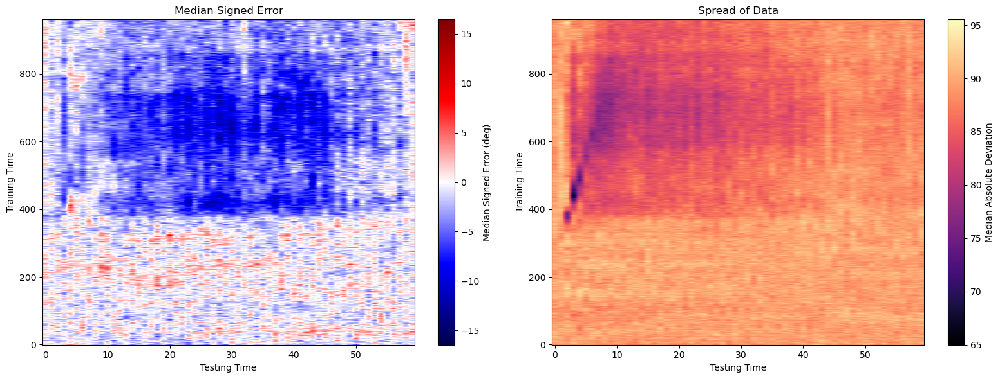

In [8]:
import numpy as np
import matplotlib.pyplot as plt
import os

summary_outdir = '/System/Volumes/Data/misc/data12/sjapee/Sebastian-OrientationImagery/!Important Data/test'
subjects = [f"S{i:02}" for i in range(1, 21)]

all_medians = []
all_mads = []

for subject in subjects:
    median_errors = np.load(os.path.join(summary_outdir, f"{subject}_median_errors.npy"))
    mad_errors = np.load(os.path.join(summary_outdir, f"{subject}_mad_errors.npy"))
    all_medians.append(median_errors)
    all_mads.append(mad_errors)

# Convert to arrays: (n_subjects, n_test_times, n_train_times)
all_medians = np.array(all_medians)
all_mads = np.array(all_mads)

# Pool across subjects (e.g. median)
pooled_median_errors = np.nanmedian(all_medians, axis=0)
pooled_mad_errors = np.nanmedian(all_mads, axis=0)

plt.figure(figsize=(16, 6))  # wider figure

vmax = np.nanmax(np.abs(pooled_median_errors))
vmin = -vmax

plt.subplot(1, 2, 1)
plt.imshow(pooled_median_errors.T, origin="lower", aspect="auto", cmap="seismic", vmin=vmin, vmax=vmax)
plt.colorbar(label="Median Signed Error (deg)")
plt.xlabel("Testing Time")
plt.ylabel("Training Time")
plt.title("Median Signed Error")

plt.subplot(1, 2, 2)
plt.imshow(pooled_mad_errors.T, origin="lower", aspect="auto", cmap="magma")
plt.colorbar(label="Median Absolute Deviation")
plt.xlabel("Testing Time")
plt.ylabel("Training Time")
plt.title("Spread of Data")

plt.tight_layout()
plt.show()


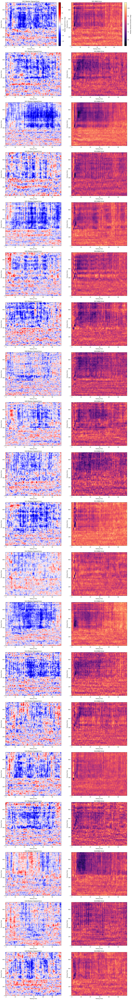

In [9]:
import numpy as np
import matplotlib.pyplot as plt
import os

summary_outdir = '/System/Volumes/Data/misc/data12/sjapee/Sebastian-OrientationImagery/!Important Data/test'
subjects = [f"S{i:02}" for i in range(1, 21)]

n_subjects = len(subjects)
ncols = 2  # one col for median, one for mad
nrows = n_subjects  # one row per subject

fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(16, 6*nrows), squeeze=False)

for i, subject in enumerate(subjects):
    median_errors = np.load(os.path.join(summary_outdir, f"{subject}_median_errors.npy"))
    mad_errors = np.load(os.path.join(summary_outdir, f"{subject}_mad_errors.npy"))

    vmax_median = np.nanmax(np.abs(median_errors))
    vmin_median = -vmax_median

    ax_median = axes[i, 0]
    im1 = ax_median.imshow(median_errors.T, origin="lower", aspect="auto",
                           cmap="seismic", vmin=vmin_median, vmax=vmax_median)
    ax_median.set_title(f"{subject} Median Signed Error")
    ax_median.set_xlabel("Testing Time")
    ax_median.set_ylabel("Training Time")
    if i == 0:
        fig.colorbar(im1, ax=ax_median, fraction=0.046, pad=0.04, label="Median Signed Error (deg)")

    ax_mad = axes[i, 1]
    im2 = ax_mad.imshow(mad_errors.T, origin="lower", aspect="auto",
                       cmap="magma")
    ax_mad.set_title(f"{subject} MAD Error")
    ax_mad.set_xlabel("Testing Time")
    ax_mad.set_ylabel("Training Time")
    if i == 0:
        fig.colorbar(im2, ax=ax_mad, fraction=0.046, pad=0.04, label="Median Absolute Deviation (deg)")

plt.tight_layout()
plt.show()
